In [13]:
%pylab inline
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML

Populating the interactive namespace from numpy and matplotlib


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/magics/pylab.py:159: UserWarning: pylab import has clobbered these variables: ['time']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


# Building a Robot Simulator in 2D

In [14]:
# Perfect sensor
def sense(x):
    return x

### Euler integration

In [42]:
def simulate(Δt, x, u):
    x += Δt * u
    return x

def simulate_wind_const(Δt, x, u):
    w = [0.1,0.1]
    x += Δt * (u + w)
    return x

def simulate_wind_rand(Δt, x, u):
    w = np.random.normal(0, 0.1, 2)
    x += Δt * (u + w)
    return x

### Control Methods

In [22]:
# Straight line
def control(t,y):
    ux = 3*t
    uy = t
    return array([ux, uy])

# Normal ellipse
def control_1(t, y):
    ux = -sin(t)
    uy = cos(t)
    return array([ux, uy])

# Tilt the ellipse 35 degrees
def control_2(t, y):
    ux = -2*sin(t) + cos(t)*0.35
    uy = cos(t) - sin(t)*0.35
    return array([ux, uy])

# Mobius strip shape
def control_3(t, y):
    ux = -sin(t)
    uy = 2*cos(2*t)
    return array([ux, uy])

# Normal circle for wind simulation
def control_4(t, y):
    ux = -sin(t)
    uy = cos(t)
    return array([ux, uy])

### Straight Line

In [249]:
tf = 10.
Δt = 0.1    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval


# Initial conditions
x = array([7., 2.])
x_log = [copy(x)]

for t in time:
    y = sense(x)
    u = control(t, y)    
    x = simulate(Δt, x, u)
    x_log.append(copy(x))
    
x_log = array(x_log)

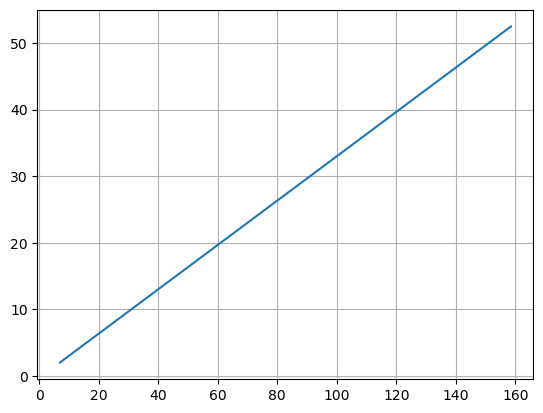

In [250]:
grid()
plot(x_log[:,0], x_log[:,1])

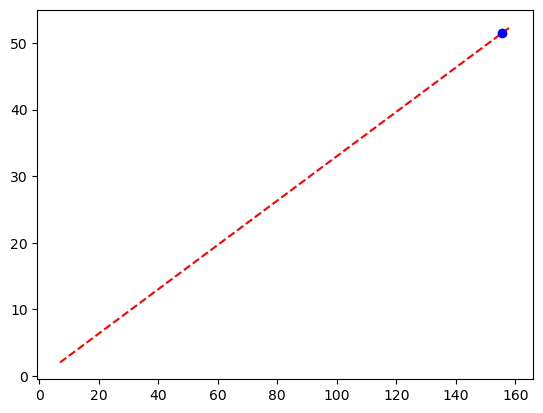

In [251]:
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display    
from IPython.display import HTML
    
fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    plot(x_log[:,0], x_log[:,1], 'r--')
    
    # Initial conditions
    plot(x_log[t,0], x_log[t,1], 'bo')
    
    

anim = animation.FuncAnimation(fig, animate, frames=len(time), interval=60)

HTML(anim.to_jshtml())

### Normal Ellipse

In [23]:
tf = 10.
Δt = 0.1    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval


# Initial conditions
x = array([5., 2.])
x_log = [copy(x)]

for t in time:
    y = sense(x)
    u = control_1(t, y)    
    x = simulate(Δt, x, u)
    x_log.append(copy(x))
    
x_log = array(x_log)

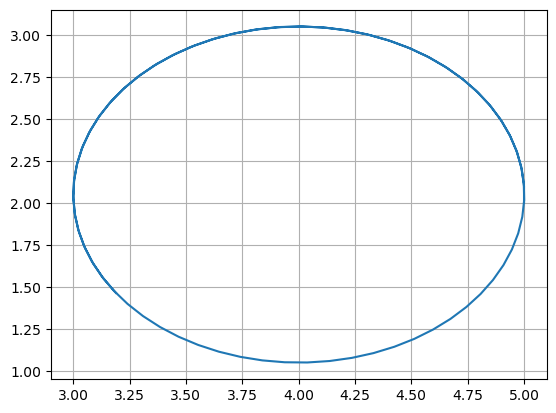

In [24]:
grid()
plot(x_log[:,0], x_log[:,1])

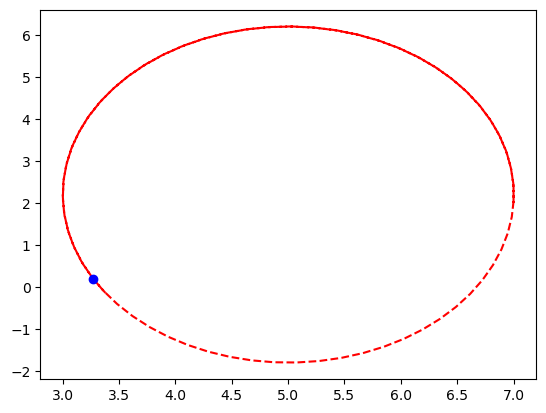

In [237]:
fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    plot(x_log[:,0], x_log[:,1], 'r--')
    
    # Initial conditions
    plot(x_log[t,0], x_log[t,1], 'bo')
    
    

anim = animation.FuncAnimation(fig, animate, frames=len(time), interval=60)

HTML(anim.to_jshtml())

### Tilted Ellipse

In [11]:
tf = 10.
Δt = 0.1    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval


# Initial conditions
x = array([5., 2.])
x_log = [copy(x)]

for t in time:
    y = sense(x)
    u = control_2(t, y)    
    x = simulate(Δt, x, u)
    x_log.append(copy(x))
    
x_log_2 = array(x_log)

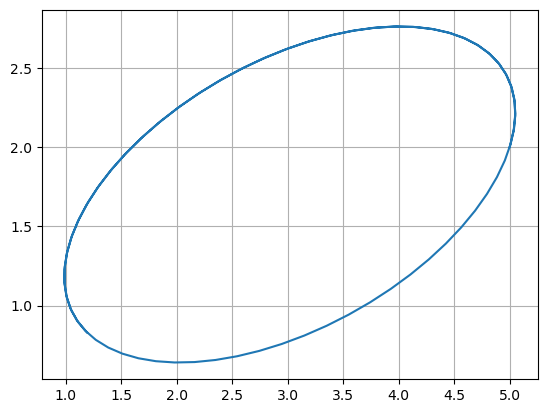

In [12]:
grid()
plot(x_log_2[:,0], x_log_2[:,1])

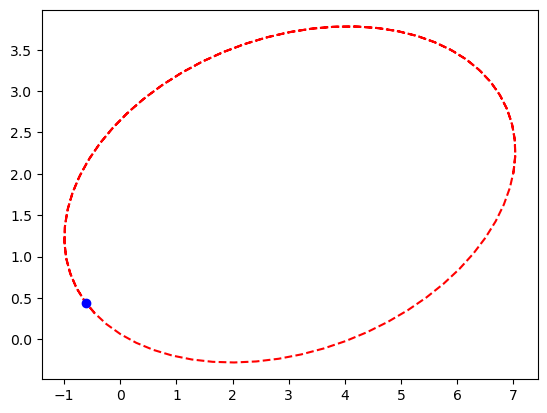

In [278]:
fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    plot(x_log_2[:,0], x_log_2[:,1], 'r--')
    
    # Initial conditions
    plot(x_log_2[t,0], x_log_2[t,1], 'bo')
    
    

anim = animation.FuncAnimation(fig, animate, frames=len(time), interval=60)

HTML(anim.to_jshtml())

### Mobius Strip

In [289]:
tf = 10.
Δt = 0.1    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval


# Initial conditions
x = array([1., 0.])
x_log = [copy(x)]

for t in time:
    y = sense(x)
    u = control_3(t, y)    
    x = simulate(Δt, x, u)
    x_log.append(copy(x))
    
x_log_3 = array(x_log)

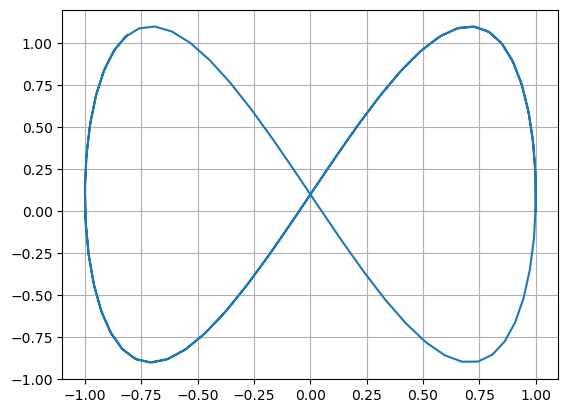

In [290]:
grid()
plot(x_log_3[:,0], x_log_3[:,1])

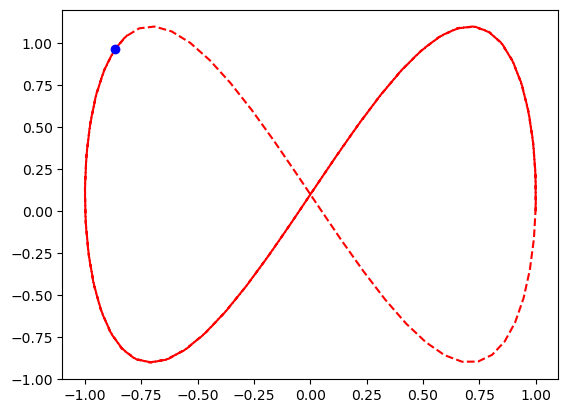

In [243]:
fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    plot(x_log_3[:,0], x_log_3[:,1], 'r--')
    
    # Initial conditions
    plot(x_log_3[t,0], x_log_3[t,1], 'bo')
    
    

anim = animation.FuncAnimation(fig, animate, frames=len(time), interval=60)

HTML(anim.to_jshtml())

### Ellipse with Constant Wind

In [50]:
tf = 10.
Δt = 0.1    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval


# Initial conditions
x = array([1., 0.])
x_log_4 = [copy(x)]

for t in time:
    y = sense(x)
    u = control_4(t, y)    
    x = simulate_wind_const(Δt, x, u)
    x_log_4.append(copy(x))
    
x_log_4 = array(x_log_4)

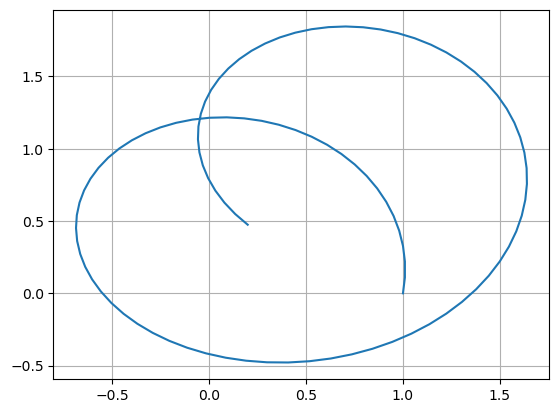

In [51]:
grid()
plot(x_log_4[:,0], x_log_4[:,1])

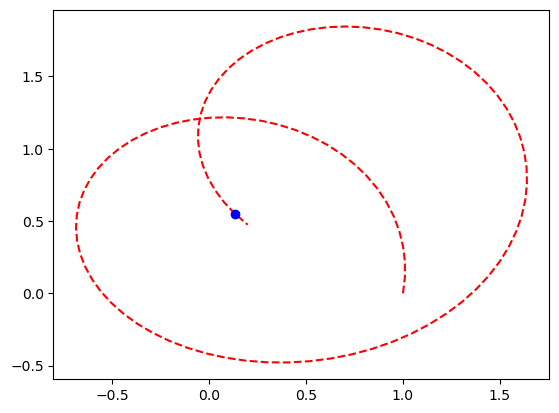

In [52]:
fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    plot(x_log_4[:,0], x_log_4[:,1], 'r--')
    
    # Initial conditions
    plot(x_log_4[t,0], x_log_4[t,1], 'bo')
    
    

anim = animation.FuncAnimation(fig, animate, frames=len(time), interval=60)

HTML(anim.to_jshtml())

### Ellipse with Random Wind

In [45]:
tf = 10.
Δt = 0.1    # Time step
time = linspace(0.,tf, int(tf / Δt) + 1)  # Time interval


# Initial conditions
x = array([1., 0.])
x_log_5 = [copy(x)]

for t in time:
    y = sense(x)
    u = control_4(t, y)    
    x = simulate_wind_rand(Δt, x, u)
    x_log_5.append(copy(x))
    
x_log_5 = array(x_log_5)

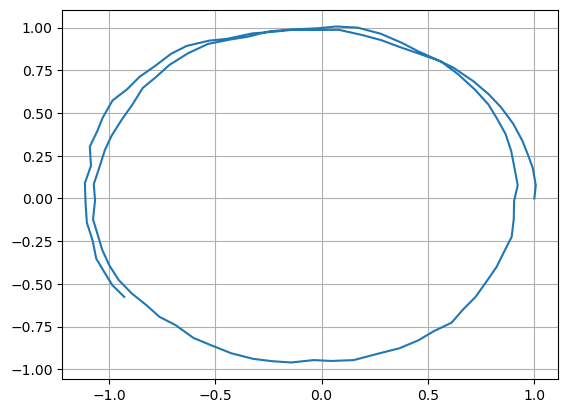

In [46]:
grid()
plot(x_log_5[:,0], x_log_5[:,1])

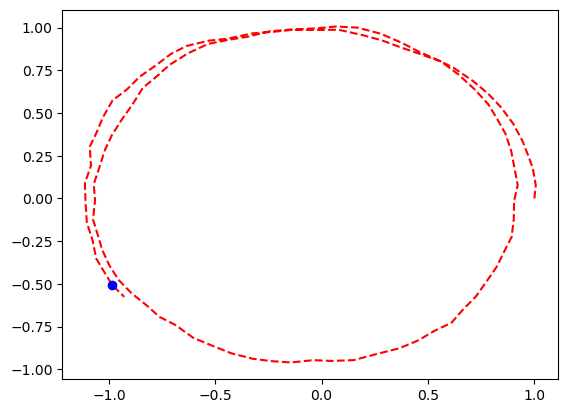

In [47]:
fig, ax = plt.subplots()

def animate(t):
    ax.clear()
    
    # Path
    plot(x_log_5[:,0], x_log_5[:,1], 'r--')
    
    # Initial conditions
    plot(x_log_5[t,0], x_log_5[t,1], 'bo')
    
    

anim = animation.FuncAnimation(fig, animate, frames=len(time), interval=60)

HTML(anim.to_jshtml())